In [1]:
import pandas as pd

In [2]:
df = pd.read_csv("Admission_Predict_Ver1.1.csv")
df.columns = [x.strip() for x in df.columns]
df.drop(columns=['Serial No.'], inplace=True)

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [4]:
df.insert(0,"x_0", 1)

In [5]:
df.sample(4)

,x_0,GRE Score,TOEFL Score,University Rating,SOP,LOR,CGPA,Research,Chance of Admit
53,1,324,112,4,4.0,2.5,8.10,1,0.72
479,1,325,110,4,4.5,4.0,8.96,1,0.79
104,1,326,112,3,3.5,3.0,9.05,1,0.74
442,1,331,116,4,4.5,4.5,9.44,1,0.92


In [6]:
df.shape

(500, 9)

In [7]:
def Hypo(theta, x):
    return np.dot(x,theta)

In [8]:
df.sample()

,x_0,GRE Score,TOEFL Score,University Rating,SOP,LOR,CGPA,Research,Chance of Admit
115,1,310,106,4,4.5,4.5,9.04,1,0.66


In [9]:
def Cost_Fun(x, y, theta):
    error = Hypo(theta, x) - y
    return (1 / (2 * len(x))) * np.sum(np.square(error))

In [10]:
def der(theta, x, y, alpha):
    error = Hypo(theta, x) - y
    return theta - ((alpha / len(x)) * np.dot(x.T, error))

In [11]:
def Normalize(x, column):
    for y in column:
        x[y] = (x[y] - x[y].min()) / (x[y].max() - x[y].min())
    return x

In [12]:
column = ['GRE Score', 'TOEFL Score', 'CGPA']
df = Normalize(df, column)

In [13]:
x = df[df.columns[:-1]].to_numpy()
y = df['Chance of Admit'].to_numpy().reshape(-1, 1) * 100

In [14]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y , random_state=42, train_size=0.8)

In [15]:
alpha = 0.005
threshold = 1e-100
theta = np.ones((x_train.shape[1], 1))

In [16]:
diff = Cost_Fun(x_train, y_train, theta)
print(f"Inital Cost: {diff:.4f}")

iter = 0
mydict = {}
mydict[f"Iter_{iter}"] = diff

while diff >= threshold:
    first = Cost_Fun(x_train, y_train, theta)
    theta = der(theta, x_train, y_train, alpha)
    last = Cost_Fun(x_train, y_train, theta)
    diff = first - last
    iter += 1
    mydict[f"Iter_{iter}"] = last
    
    print()
    print(f"Iteration: {iter}")
    print(f"Calculated Cost: {last:4f}")
    print(f"Cost Difference: {diff:.4f}")

print("\nFinal theta:\n", theta)

Inital Cost: 1819.6711

Iteration: 1
Calculated Cost: 1219.472906
Cost Difference: 600.1982

Iteration: 2
Calculated Cost: 824.833222
Cost Difference: 394.6397

Iteration: 3
Calculated Cost: 565.346321
Cost Difference: 259.4869

Iteration: 4
Calculated Cost: 394.721106
Cost Difference: 170.6252

Iteration: 5
Calculated Cost: 282.521628
Cost Difference: 112.1995

Iteration: 6
Calculated Cost: 208.736545
Cost Difference: 73.7851

Iteration: 7
Calculated Cost: 160.208593
Cost Difference: 48.5280

Iteration: 8
Calculated Cost: 128.286995
Cost Difference: 31.9216

Iteration: 9
Calculated Cost: 107.283952
Cost Difference: 21.0030

Iteration: 10
Calculated Cost: 93.459790
Cost Difference: 13.8242

Iteration: 11
Calculated Cost: 84.355707
Cost Difference: 9.1041

Iteration: 12
Calculated Cost: 78.355067
Cost Difference: 6.0006

Iteration: 13
Calculated Cost: 74.394946
Cost Difference: 3.9601

Iteration: 14
Calculated Cost: 71.776482
Cost Difference: 2.6185

Iteration: 15
Calculated Cost: 70.04

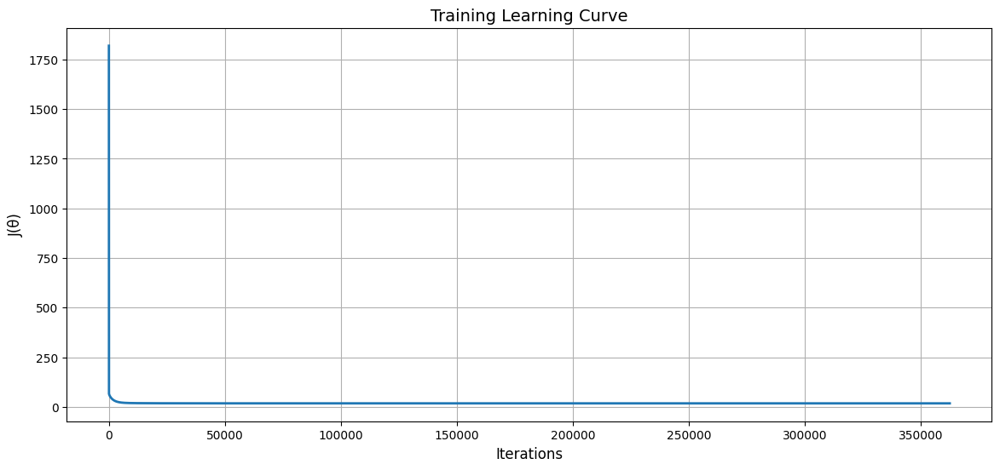

In [17]:
y_values = [x for x in mydict.values()]
x_value = range(len(mydict.keys()))

plt.figure(figsize=(14,6))
plt.plot(x_value, y_values, color = "tab:blue", linewidth = 2)
plt.xlabel("Iterations", fontsize =  12)
plt.ylabel("J(θ)", fontsize = 12)
plt.title("Training Learning Curve", fontsize = 14)
plt.grid(True)
plt.show()

In [18]:
from sklearn.metrics import r2_score, mean_squared_error

y_pred = Hypo(theta, x_test)
score = r2_score(y_test,y_pred)
print("R² score: {}".format(score))
print("MSE: {}".format(mean_squared_error(y_test,y_pred)))

R² score: 0.8188430290155367
MSE: 37.04660056632274


In [19]:
y_pred = pd.DataFrame(y_pred, columns=["Predicted"])
y_actual = pd.DataFrame(y_test, columns=["Actual"])
df = pd.concat([y_pred, y_actual], axis = 1)
df

,Predicted,Actual
0,91.457463,93.0
1,79.518100,84.0
2,57.266025,39.0
3,70.736949,77.0
4,81.588274,74.0
...,...,...
95,43.563141,42.0
96,68.664273,72.0
97,78.598850,72.0
98,73.469442,67.0


In [20]:
# y_actual.assign(theta = y_pred)

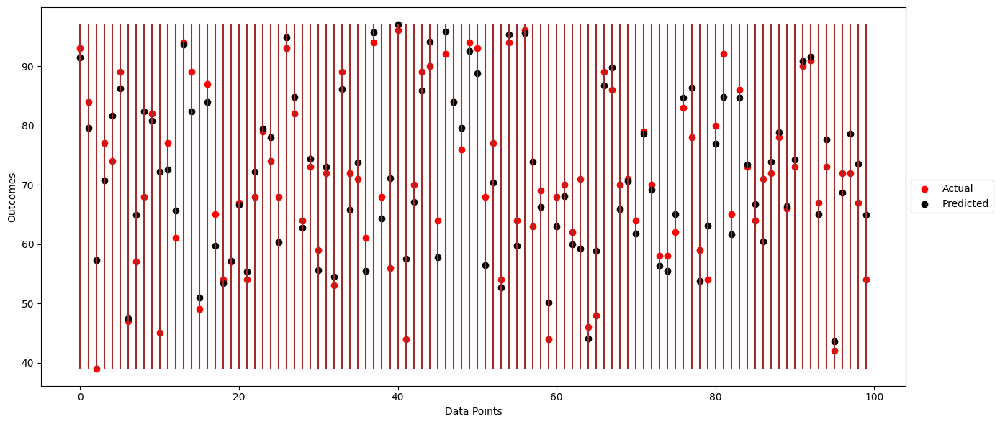

In [21]:
plt.figure(figsize = (14,6))
plt.scatter([x for x in range(len(y_actual))], y_actual, color = "red")
plt.scatter([x for x in range(len(y_pred))], y_pred, color = "black")
plt.vlines([x for x in range(len(y_pred))] , color = "brown", ymin = min(y_actual.to_numpy().min(), y_pred.to_numpy().min()) , ymax = max(y_actual.to_numpy().max(), y_pred.to_numpy().max()))
plt.xlabel("Data Points")
plt.ylabel("Outcomes")
plt.legend(["Actual", "Predicted"], loc = "center left" , bbox_to_anchor = (1,0.5))
plt.tight_layout()
plt.show()